<a href="https://colab.research.google.com/github/plaban1981/Langchain_usecases/blob/main/Create_Custom_Tools_for_chatbots.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
! pip install -qU langchain openai transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 759.0/759.0 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.9/71.9 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 55.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.0/90.0 kB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 89.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 23.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.6/149.6 kB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 14.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 28.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 kB 5.2 MB/s eta 0:00:00


In [ ]:
from langchain.chat_models import ChatOpenAI
from langchain.chains.conversation.memory import ConversationBufferWindowMemory
from getpass import getpass
#
openai_api_key = getpass()
#
llm = ChatOpenAI(openai_api_key = openai_api_key ,
                 temperature = 0,
                 model_name = "gpt-3.5-turbo")
#initialize conversational memory
conversational_memory = ConversationBufferWindowMemory(memory_key = "chat_history",
                                                       k=5,
                                                       return_messages=True
                                                       )

··········


When defining a tool like this using the BaseTool template we must define name and description attributes, alongside _run and _arun methods. 
* When a tool us used the _run method is called by default. 
* The _arun method is called when the tool is to be used asyncronously. We do not cover that in this walkthrough so for now we create it with a NotImplementedError

In [ ]:
from langchain.tools import BaseTool
from math import pi
from typing import Union

class CircumferenceTool(BaseTool):
    name = "Circumference calculator"
    description = "use this tool when you need to calculate a circumference using the radius of a circle"

    def _run(self, radius: Union[int, float]):
        return float(radius)*2.0*pi
    
    def _arun(self, radius: Union[int, float]):
        raise NotImplementedError("This tool does not support async")


## Initialize Agent

#### Agent Types :

[<AgentType.ZERO_SHOT_REACT_DESCRIPTION: 'zero-shot-react-description'>, <AgentType.REACT_DOCSTORE: 'react-docstore'>, <AgentType.SELF_ASK_WITH_SEARCH: 'self-ask-with-search'>, <AgentType.CONVERSATIONAL_REACT_DESCRIPTION: 'conversational-react-description'>, <AgentType.CHAT_ZERO_SHOT_REACT_DESCRIPTION: 'chat-zero-shot-react-description'>, <AgentType.CHAT_CONVERSATIONAL_REACT_DESCRIPTION: 'chat-conversational-react-description'>, <AgentType.STRUCTURED_CHAT_ZERO_SHOT_REACT_DESCRIPTION: 'structured-chat-zero-shot-react-description'>]

In [ ]:
from langchain.agents import initialize_agent
tools = [CircumferenceTool()]
#
agent = initialize_agent(
    agent ='chat-conversational-react-description',
    tools =tools,
    llm=llm,
    verbose=True,
    max_iterations=3,
    early_stopping_method = 'generate',
    memory = conversational_memory
)

## Run the agent

In [ ]:
agent("calculate the circumference of a circle having a radius 0f 781 mm.Provide the result in cm")



> Entering new AgentExecutor chain...
{
    "action": "Final Answer",
    "action_input": "The circumference of a circle having a radius of 781 mm is approximately 490.717 cm."
}

> Finished chain.


{'input': 'calculate the circumference of a circle having a radius 0f 781 mm.Provide the result in cm',
 'chat_history': [HumanMessage(content='calculate the circumference of a circle having a radius 0f 781 mm', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 781 mm is approximately 4907.17 mm.', additional_kwargs={}, example=False)],
 'output': 'The circumference of a circle having a radius of 781 mm is approximately 490.717 cm.'}

In [ ]:
3.142 * 2 * 781

4907.804

* actual result is 4907.804

## existig prompt

In [ ]:
print(agent.agent.llm_chain.prompt.messages[0])

prompt=PromptTemplate(input_variables=[], output_parser=None, partial_variables={}, template='Assistant is a large language model trained by OpenAI.\n\nAssistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.\n\nAssistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, Assistant is able to generate its own text based on the input it receives, allowing it to engage in discussions and provide explanations and descriptions on a wide

In [ ]:
print(agent.agent.llm_chain.prompt.messages[0].prompt.template)

Assistant is a large language model trained by OpenAI.

Assistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.

Assistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, Assistant is able to generate its own text based on the input it receives, allowing it to engage in discussions and provide explanations and descriptions on a wide range of topics.

Overall, Assistant is a powerful system that can help with a wide range of task

## Customize the prompt to retieve the exact answer

In [ ]:
sys_msg = """Assistant is a large language model trained by OpenAI.

Assistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.

Assistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, Assistant is able to generate its own text based on the input it receives, allowing it to engage in discussions and provide explanations and descriptions on a wide range of topics.

Unfortunately, Assistant is terrible at maths. When provided with math questions, no matter how simple, assistant always refers to it's trusty tools and absolutely does NOT try to answer math questions by itself

Overall, Assistant is a powerful system that can help with a wide range of tasks and provide valuable insights and information on a wide range of topics. Whether you need help with a specific question or just want to have a conversation about a particular topic, Assistant is here to assist."""

In [ ]:
new_prompt = agent.agent.create_prompt(
    system_message = sys_msg,
    tools = tools
)

In [ ]:
new_prompt

ChatPromptTemplate(input_variables=['input', 'chat_history', 'agent_scratchpad'], output_parser=None, partial_variables={}, messages=[SystemMessagePromptTemplate(prompt=PromptTemplate(input_variables=[], output_parser=None, partial_variables={}, template="Assistant is a large language model trained by OpenAI.\n\nAssistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.\n\nAssistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, A

In [ ]:
agent.agent.llm_chain.prompt = new_prompt

In [ ]:
agent.agent.llm_chain.prompt.messages[0].prompt.template

"Assistant is a large language model trained by OpenAI.\n\nAssistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.\n\nAssistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, Assistant is able to generate its own text based on the input it receives, allowing it to engage in discussions and provide explanations and descriptions on a wide range of topics.\n\nUnfortunately, Assistant is terrible at maths. When provided with math q

In [ ]:
agent("Can you calculate calculate the circumference of a circle having a radius of 781 mm. Provide the result in cm")



> Entering new AgentExecutor chain...
```json
{
    "action": "Final Answer",
    "action_input": "The circumference of a circle having a radius of 781 mm is approximately 490.717 cm."
}
```

> Finished chain.


{'input': 'Can you calculate calculate the circumference of a circle having a radius of 781 mm. Provide the result in cm',
 'chat_history': [HumanMessage(content='calculate the circumference of a circle having a radius 0f 781 mm', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 781 mm is approximately 4907.17 mm.', additional_kwargs={}, example=False),
  HumanMessage(content='calculate the circumference of a circle having a radius 0f 781 mm.Provide the result in cm', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 781 mm is approximately 490.717 cm.', additional_kwargs={}, example=False),
  HumanMessage(content='Can you calculate calculate the circumference of a circle having a radius of 7.81 mm', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 7.81 mm is approximately 49.07 mm.', additional_kwargs={}, exampl

## Image Captioning

In [ ]:
import torch
from transformers import BlipProcessor,BlipForConditionalGeneration
#
hf_model = "Salesforce/blip-image-captioning-large"
#
device = "cuda" if torch.cuda.is_available() else "cpu"
#
processor = BlipProcessor.from_pretrained(hf_model)
model = BlipForConditionalGeneration.from_pretrained(hf_model).to(device)

## Prepare Custom Tool for Image Captioning

In [ ]:
import requests
desc = """use this tool when you are provided with the URL of an image that would like to be described. It will return a simpla caption describing the image"""
#
class ImageCaptionTool(BaseTool):
  name = "Image captioner"
  description = desc

  def _run(self, url: str):
        # download the image and convert to PIL object
        image = Image.open(requests.get(url, stream=True).raw).convert('RGB')
        # preprocess the image
        inputs = processor(image, return_tensors="pt").to(device)
        # generate the caption
        out = model.generate(**inputs, max_new_tokens=20)
        # get the caption
        caption = processor.decode(out[0], skip_special_tokens=True)
        return caption
    
  def _arun(self, query: str):
        raise NotImplementedError("This tool does not support async")

tools = [ImageCaptionTool()]

In [ ]:
from langchain.agents import initialize_agent
#
agent = initialize_agent(
    agent ='chat-conversational-react-description',
    tools =tools,
    llm=llm,
    verbose=True,
    max_iterations=3,
    early_stopping_method = 'generate',
    memory = conversational_memory
)

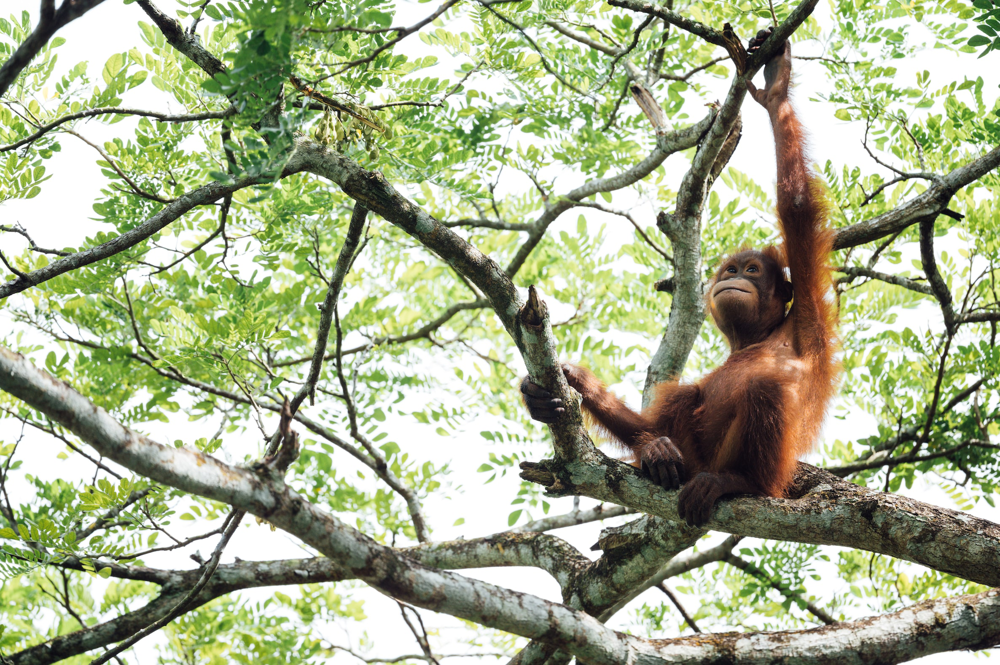

In [ ]:
from PIL import Image
#
img_url = 'https://images.unsplash.com/photo-1616128417859-3a984dd35f02?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2372&q=80'
#
image = Image.open(requests.get(img_url, stream=True).raw).convert('RGB')
image

In [ ]:
from PIL import Image
#
img_url = 'https://images.unsplash.com/photo-1616128417859-3a984dd35f02?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2372&q=80'
#
agent(f"What does this image show?\n{img_url}")



> Entering new AgentExecutor chain...
{
    "action": "Image captioner",
    "action_input": "https://images.unsplash.com/photo-1616128417859-3a984dd35f02?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2372&q=80"
}
Observation: there is a monkey that is sitting in a tree
Thought:{
    "action": "Final Answer",
    "action_input": "The image shows a monkey sitting in a tree."
}

> Finished chain.


{'input': 'What does this image show?\nhttps://images.unsplash.com/photo-1616128417859-3a984dd35f02?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2372&q=80',
 'chat_history': [HumanMessage(content='calculate the circumference of a circle having a radius 0f 781 mm.Provide the result in cm', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 781 mm is approximately 490.717 cm.', additional_kwargs={}, example=False),
  HumanMessage(content='Can you calculate calculate the circumference of a circle having a radius of 7.81 mm', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 7.81 mm is approximately 49.07 mm.', additional_kwargs={}, example=False),
  HumanMessage(content='Can you calculate calculate the circumference of a circle having a radius of 7.81 mm.Provide the result in cm.', additional_kwargs={}, example=False),
  AIMessage(co

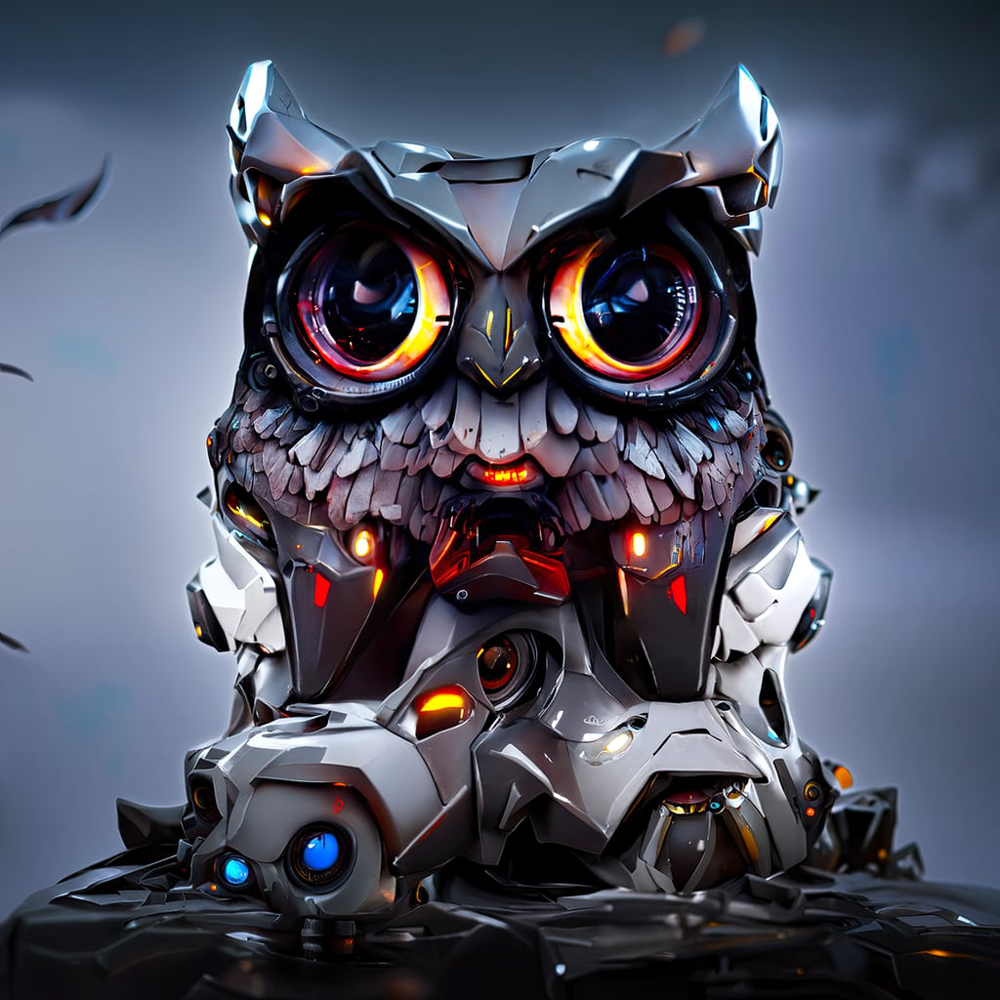

In [32]:
image = Image.open(requests.get("https://pharmapsychotic.com/images/robo_owl.jpg", stream=True).raw).convert('RGB')
image

In [31]:
agent('can you provide a caption for the below url?\n{"https://pharmapsychotic.com/images/robo_owl.jpg"}')



> Entering new AgentExecutor chain...
{
    "action": "Image captioner",
    "action_input": "https://pharmapsychotic.com/images/robo_owl.jpg"
}
Observation: there is a large owl statue with glowing eyes and a large head
Thought:{
    "action": "Final Answer",
    "action_input": "The image shows a large owl statue with glowing eyes and a large head."
}

> Finished chain.


{'input': 'can you provide a caption for the below url?\n{"https://pharmapsychotic.com/images/robo_owl.jpg"}',
 'chat_history': [HumanMessage(content='Can you calculate calculate the circumference of a circle having a radius of 7.81 mm', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 7.81 mm is approximately 49.07 mm.', additional_kwargs={}, example=False),
  HumanMessage(content='Can you calculate calculate the circumference of a circle having a radius of 7.81 mm.Provide the result in cm.', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 7.81 mm is approximately 4.905 cm.', additional_kwargs={}, example=False),
  HumanMessage(content='Can you calculate calculate the circumference of a circle having a radius of 781 mm', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 781 mm is approximately 4907.17 mm.', add

## agent prompt template

In [33]:
print(agent.agent.llm_chain.prompt.messages[0].prompt.template)

Assistant is a large language model trained by OpenAI.

Assistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.

Assistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, Assistant is able to generate its own text based on the input it receives, allowing it to engage in discussions and provide explanations and descriptions on a wide range of topics.

Overall, Assistant is a powerful system that can help with a wide range of task

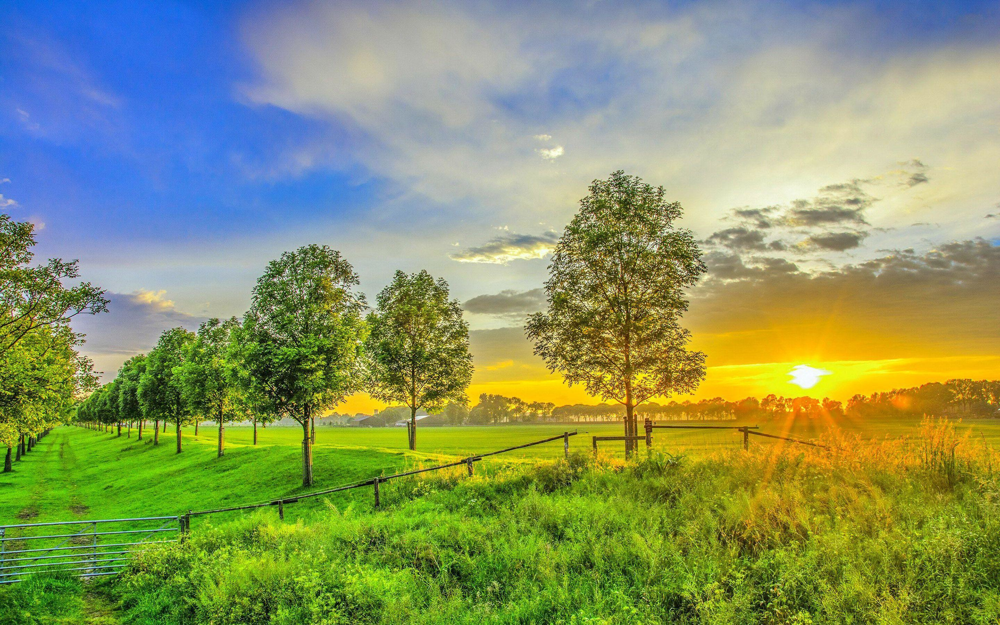

In [34]:
url = "https://wallpaperset.com/w/full/0/d/5/183330.jpg"
image = Image.open(requests.get(url, stream=True).raw).convert('RGB')
image

In [37]:
url = "https://wallpaperset.com/w/full/0/d/5/183330.jpg"
agent(f'What does the image in the url provided tell?\n{url}')



> Entering new AgentExecutor chain...
{
    "action": "Image captioner",
    "action_input": "https://wallpaperset.com/w/full/0/d/5/183330.jpg"
}
Observation: arafed view of a field with a fence and trees at sunset
Thought:{
    "action": "Final Answer",
    "action_input": "The image in the provided URL shows a view of a field with a fence and trees at sunset."
}

> Finished chain.


{'input': 'What does the image in the url provided tell?\nhttps://wallpaperset.com/w/full/0/d/5/183330.jpg',
 'chat_history': [HumanMessage(content='Can you calculate calculate the circumference of a circle having a radius of 781 mm. Provide the result in cm', additional_kwargs={}, example=False),
  AIMessage(content='The circumference of a circle having a radius of 781 mm is approximately 490.717 cm.', additional_kwargs={}, example=False),
  HumanMessage(content='What does this image show?\nhttps://images.unsplash.com/photo-1616128417859-3a984dd35f02?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2372&q=80', additional_kwargs={}, example=False),
  AIMessage(content='The image shows a monkey sitting in a tree.', additional_kwargs={}, example=False),
  HumanMessage(content='can you provide a caption for the below url?\n{"https://pharmapsychotic.com/images/robo_owl.jpg"}', additional_kwargs={}, example=False),
  AIMessage(content='The image shows 